In [1]:
####################################################################################
'''
Importing Libraries

1. Scientific functions:

    a) numpy
    b) scipy
    c) JAX (GPU)

2. Plotting:

    a) matplotlib

3. Just-In-Time compilation : JAX
'''
####################################################################################

import scipy as sc
import torch as torch
from matplotlib.colors import LogNorm

import numpy as np
import jax
import jax.numpy as jnp

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.gridspec as gridspec
import seaborn

from sys import getsizeof
import pathlib,json,os,time
from scipy.interpolate import Rbf


import warnings
warnings.filterwarnings("ignore")

from tqdm import tqdm

from scipy.interpolate import interp1d

jax.config.update('jax_enable_x64', True) # Set float-64 as a Default variable type.

In [2]:
%%html
<style>
.jp-Notebook {
  --jp-notebook-max-width: 98%;
}</style>

In [3]:
####################################################################################
'''
Setting up and Mounting Google Drive for saving data
'''
####################################################################################


folder_path = '/Volumes/Extreme Pro/2D_Burgers_stochastic_wrapped'

folder_path_run_2 = '/Volumes/Extreme Pro/2D_Burgers_stochastic_wrapped_Run_2'

folder_path_run_3 = '/Volumes/Extreme Pro/2D_Burgers_stochastic_wrapped_Run_3'

folder_path_run_4 = '/Volumes/Extreme Pro/2D_Burgers_stochastic_wrapped_Run_4'

folder_path_run_5 = '/Volumes/Extreme Pro/2D_Burgers_stochastic_wrapped_Run_5'

folder_path_run_6 = '/Volumes/Extreme Pro/2D_Burgers_stochastic_wrapped_Run_6'

In [4]:
####################################################################################
'''
General definitions and set-up
'''
####################################################################################

pi = np.pi
N = 2**11 # No. of collocation points
L = 2*pi   # Domain length
N_particles = 2**20
dx = L/N

A_0 = L**2

linear_array = jnp.linspace(0, L, N+1)[:-1]  # 1D mesh grid in real-space

mesh_grid = jnp.stack(jnp.meshgrid(linear_array, linear_array, indexing='ij')) # 2D meshgrid


dt = 1e-3           # step size
T_final = 1000   #Final time

save_interval = 2   # frequency of saving data

steps = int(save_interval/dt) + 1
T_final_steps = int(T_final/save_interval)

t = np.arange(0, T_final, save_interval)

nu = 2e-3   # Viscosity


St_run_1 = 6.25 * jnp.array([0.02, 0.1, 0.5, 2, 6, 10, 20, 40, 60, 80, 100, 200])
St_run_2 = 6.25 * jnp.array([0.8, 1, 4, 8, 15, 25, 30, 50, 70, 90, 120, 500])
St_run_3 = 6.25 * jnp.array([0.25, 3, 5, 7, 9, 12, 14, 16, 17, 19, 23, 27])
St_run_4 = 6.25 * jnp.array([0.7, 1.25, 1.5, 1.75, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5])
St_run_5 = jnp.linspace(8, 35, 12)
St_run_6 = (1/0.1579)*jnp.linspace(2/6.25,8/6.25, 12 , endpoint = False)  

# Combine all in one go
St = jnp.concatenate([St_run_1, St_run_2, St_run_3, St_run_4, St_run_5,St_run_6])

# Sort correctly
indx = jnp.argsort(St)
St_sorted = St[indx]


####################################################################################
'''
Fourier Modes, Derivative operator And Cut-off for Spectral method
'''
####################################################################################

k_x = jnp.fft.fftfreq(N, d=L/N) * 2*pi
k_y = jnp.fft.rfftfreq(N, d=L/N) * 2*pi

k_vec = jnp.stack(jnp.meshgrid(k_x, k_y, indexing='ij'))                        # 2D Fourier-space Mesh-grid

derivative_operator = 1j * k_vec                                                # Derivative operator D = \iota \vec{k}

laplacian = -jnp.sum(k_vec**2, axis=0)                                          # \nabla^2 = -|k|^2

k_over_lapacian = jnp.where( laplacian == 0 , 0 , k_vec/(-1*laplacian) )        # \vec{k}/|k|^2. for the projection onto curl-free sector

k_UV_cutoff = N//4
UV_cutoff = (jnp.sqrt(-laplacian) <= k_UV_cutoff) * 1.0                         # UV-cutoff in Fourier space

alias_mask = (jnp.sqrt(-laplacian) <= N//3) * 1.0  # Dealias Mask



shells = jnp.arange(-0.5,N//2)
shells = shells.at[0].set(0)

####################################################################################
'''
Forcing in spectral space
'''
####################################################################################

beta = 2   # Power of covarianve of Forcing
D0 = 60     # Amplitude of the Forcing


force_amp_OU = D0*UV_cutoff*jnp.where(laplacian == 0, 0, jnp.sqrt(-laplacian)**(-beta/2)) # Total forcing amplitude with proper time-stepping multiplied for OU_process

force_amp = jnp.sqrt(dt)*D0*UV_cutoff*jnp.where(laplacian == 0, 0, jnp.sqrt(-laplacian)**(-beta/2)) # Total forcing amplitude with proper time-stepping multiplied.


# For Ornstien-Uhlembeck proces

theta = jnp.eye(2)            # Charecteristic time scales for both the components
sigma = jnp.eye(2)*0.05       # Covarianve Matrix for the forcing.


####################################################################################
'''
Semi-Group operators for IFRK4 method.
'''
####################################################################################

# Fixed linear operator calculation

linear_operator = nu * laplacian  # Laplacian is already negative

SemiG = jnp.exp(linear_operator * dt)
SemiG_Half = jnp.exp(linear_operator * dt / 2)

In [5]:
St_sorted

Array([1.25000000e-01, 6.25000000e-01, 1.56250000e+00, 2.02659911e+00,
       2.53324889e+00, 3.03989867e+00, 3.12500000e+00, 3.54654845e+00,
       4.05319823e+00, 4.37500000e+00, 4.55984801e+00, 5.00000000e+00,
       5.06649778e+00, 5.57314756e+00, 6.07979734e+00, 6.25000000e+00,
       6.58644712e+00, 7.09309690e+00, 7.59974668e+00, 7.81250000e+00,
       8.00000000e+00, 9.37500000e+00, 1.04545455e+01, 1.09375000e+01,
       1.25000000e+01, 1.29090909e+01, 1.53636364e+01, 1.56250000e+01,
       1.78181818e+01, 1.87500000e+01, 2.02727273e+01, 2.18750000e+01,
       2.27272727e+01, 2.50000000e+01, 2.51818182e+01, 2.76363636e+01,
       2.81250000e+01, 3.00909091e+01, 3.12500000e+01, 3.25454545e+01,
       3.43750000e+01, 3.50000000e+01, 3.75000000e+01, 4.06250000e+01,
       4.37500000e+01, 4.68750000e+01, 5.00000000e+01, 5.31250000e+01,
       5.62500000e+01, 5.93750000e+01, 6.25000000e+01, 7.50000000e+01,
       8.75000000e+01, 9.37500000e+01, 1.00000000e+02, 1.06250000e+02,
      

In [5]:
Energy_vs_time = np.zeros(21)

for i in range(1,21):

  Energy_vs_time[i] =  jnp.sum(jnp.abs(jnp.load(f'/Volumes/Extreme Pro/2D_Burgers_stochastic/Velocity_field_{i}.npz')['v_spec'])**2)/N**2

E = jnp.load(os.path.join(folder_path, f'Energy_vs_time.npz'), allow_pickle=True)['E_t']

Energy_vs_time = jnp.append(Energy_vs_time,E)

E_k = jnp.load(os.path.join(folder_path, f'Energy_spectrum.npz'), allow_pickle=True)['E_k']

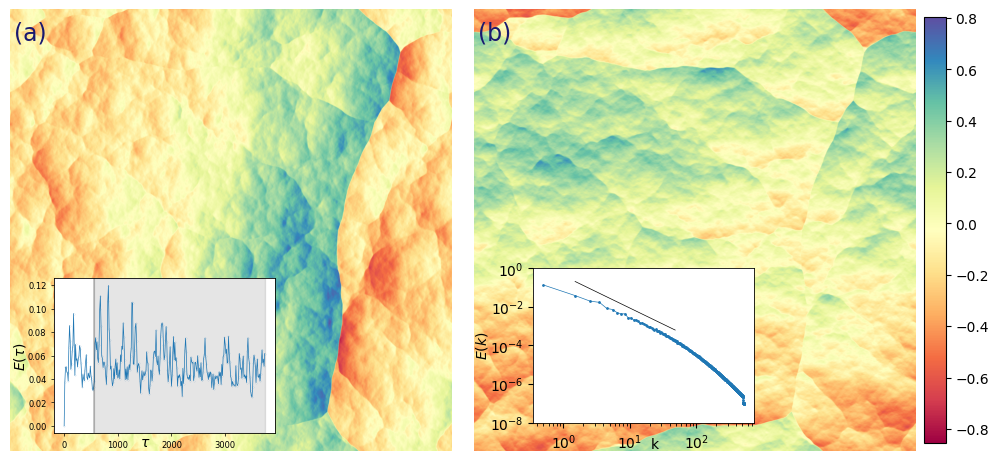

In [6]:
####################################################################################
'''
Visualization of initial condition (clean version with manually positioned insets)
'''
####################################################################################

from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Load data
u_0 = jnp.load(os.path.join(folder_path, f'Velocity_Particle_Data_{480}.npz'))['v_spec']

u_x = jnp.fft.irfft2(u_0[0], norm='ortho')
u_y = jnp.fft.irfft2(u_0[1], norm='ortho')

vmin = min(u_x.min(), u_y.min())
vmax = max(u_x.max(), u_y.max())

# Main figure
f, axarr = plt.subplots(1, 2, figsize=(10, 4.5), constrained_layout=True)

# Main fields
im0 = axarr[0].imshow(u_x.T, origin='lower', extent=[0, L, 0, L],
                      cmap='Spectral', vmin=vmin, vmax=vmax)
im1 = axarr[1].imshow(u_y.T, origin='lower', extent=[0, L, 0, L],
                      cmap='Spectral', vmin=vmin, vmax=vmax)

# Clean up axes
for ax in axarr:
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ax.spines.values():
        spine.set_visible(False)

# Add panel labels (a), (b)
axarr[0].text(0.01, 0.93, "(a)", transform=axarr[0].transAxes,
              fontsize=17, color='midnightblue')
axarr[1].text(0.01, 0.93, "(b)", transform=axarr[1].transAxes,
              fontsize=17, color='midnightblue')

# ---- Add manually positioned inset panels ----


inset0 = axarr[0].inset_axes([0.10, 0.04, 0.5, 0.35])  # (x0, y0, width, height)
inset1 = axarr[1].inset_axes([0.135, 0.0635, 0.5, 0.35])

# Example: left inset → Energy vs Time
time = np.arange(0, 600, 2) / 0.16
inset0.plot(time[:300], Energy_vs_time[:300], 'o-', linewidth= 0.5 , ms = 0.05)

inset0.axvline(time[45], linewidth=0.3, color = 'black')
inset0.axvspan(time[45], time[299], alpha=0.1, color = 'black')

inset0.tick_params(labelsize=6, width=0.5, length=2)

inset0.set_xlabel(r'$\tau$', labelpad=-10)  # move label closer (negative pulls it up)
inset0.xaxis.label.set_position((0.415, -0.04))  # (x, y) in axis fraction coords

inset0.set_ylabel(r'$E(\tau)$', labelpad = 0 )  # move label closer (negative pulls it up)
inset0.yaxis.label.set_position((0.415, 0.5))  # (x, y) in axis fraction coords


for spine in inset0.spines.values():
    spine.set_linewidth(0.6)

inset1.loglog(shells[1:N//4 + 20], E_k[1:N//4 + 20], 'o-', lw = 0.5 , ms = 1)
inset1.loglog(shells[2:50],4e-1*(shells[2:50])**(-5/3),color ='black', lw = 0.5 , ms = 1)
inset1.set_xlabel('k', labelpad=-10)  # move label closer (negative pulls it up)
inset1.xaxis.label.set_position((0.55, -0.04))  # (x, y) in axis fraction coords
inset1.set_ylim(1e-8,1e0)

inset1.set_ylabel(r'$E(k)$', labelpad = 0 )  # move label closer (negative pulls it up)
inset1.yaxis.label.set_position((0.415, 0.5))  # (x, y) in axis fraction coords


for spine in inset1.spines.values():
    spine.set_visible(True)
    spine.set_linewidth(0.6)
    spine.set_edgecolor("black")

# Add colorbar
cbar = f.colorbar(im1, ax=axarr, shrink=0.965, location='right', pad=0.01)
plt.savefig("Velocity_field.png", dpi=600, bbox_inches='tight', pad_inches=0.01)

plt.show()

In [125]:
####################################################################################
'''
Helping Function: 1.curl-free projection, 2.divergence  3.curl
'''
####################################################################################

@jax.jit
def curl_free_projection(u, k_over_lapacian = k_over_lapacian):

  return k_over_lapacian*(jnp.sum(k_vec*u,0))


@jax.jit
def divergence(u):

  return jnp.sum(derivative_operator*u,0)

@jax.jit
def curl(u):

  return jnp.fft.irfft2(derivative_operator[0]*u[1] - derivative_operator[1]*u[0] , norm = 'ortho')

In [126]:
def getPDFandCDF(field , nbins ):

    field = jnp.ravel(field)
    field = field[field >= 0]  # remove non-positive values

    if field.size == 0:
        raise ValueError("Field contains no positive values.")

    if jnp.allclose(field, field[0]):
        pdf = jnp.zeros(nbins)
        cdf = jnp.ones(nbins)
        bins = jnp.logspace(jnp.log10(1e-4), jnp.log10(jnp.sqrt(2)*pi), len(cdf))
        return pdf, bins, cdf


    bin_edges = jnp.logspace(jnp.log10(field.min()+ 1e-4), jnp.log10(jnp.sqrt(2)*pi), nbins + 1)

    hist, edges = jnp.histogram(field, bins=bin_edges)

    bins = jnp.sqrt(edges[1:] * edges[:-1])

    pdf = hist / (jnp.sum(hist) * jnp.diff(edges))
    cdf = jnp.cumsum(pdf * jnp.diff(edges))
    cdf /= cdf[-1]

    return pdf, bins, cdf

In [127]:
def calculate_rms(data):

    """Calculates the Root Mean Square (RMS) of a given array using"""
    return jnp.sqrt(jnp.mean(jnp.square(data)))

# Calculating Particle Distance Distribution And $D_2$ for a single snapshot

In [8]:
start_time = 200
end_time = 500

skip = 1
n_bins = 100


key1 = jax.random.PRNGKey(78489)
key2 = jax.random.PRNGKey(7848)


i1 = jax.random.randint(key1, (N_particles,), 0, N_particles-1)
i2 = jax.random.randint(key2, (N_particles,), 0, N_particles-1)

In [9]:
# for j in range(12):

#     rel_dist = jnp.zeros(1)
    
#     for time_stamp in tqdm(range(start_time, end_time, skip)):
    
#         with np.load(os.path.join(folder_path_run_6, f'Velocity_Particle_Data_{time_stamp}.npz')) as data: pos = data['pos_particle'][j]
    
#         dx, dy = pos[i2, 0] - pos[i1, 0], pos[i2, 1] - pos[i1, 1]
    
#         dx = dx - L * np.round(dx / L)
#         dy = dy - L * np.round(dy / L)
    
#         rel_dist = jnp.append(rel_dist, np.sqrt(dx**2 + dy**2))

#     pdf , r  , cdf = getPDFandCDF(rel_dist[1:], 100)

#     np.savez(os.path.join(folder_path_run_6, f'D2_PDF_CDF_bins_St_indx_{j}.npz') , pdf = pdf , cdf = cdf, bins = r )

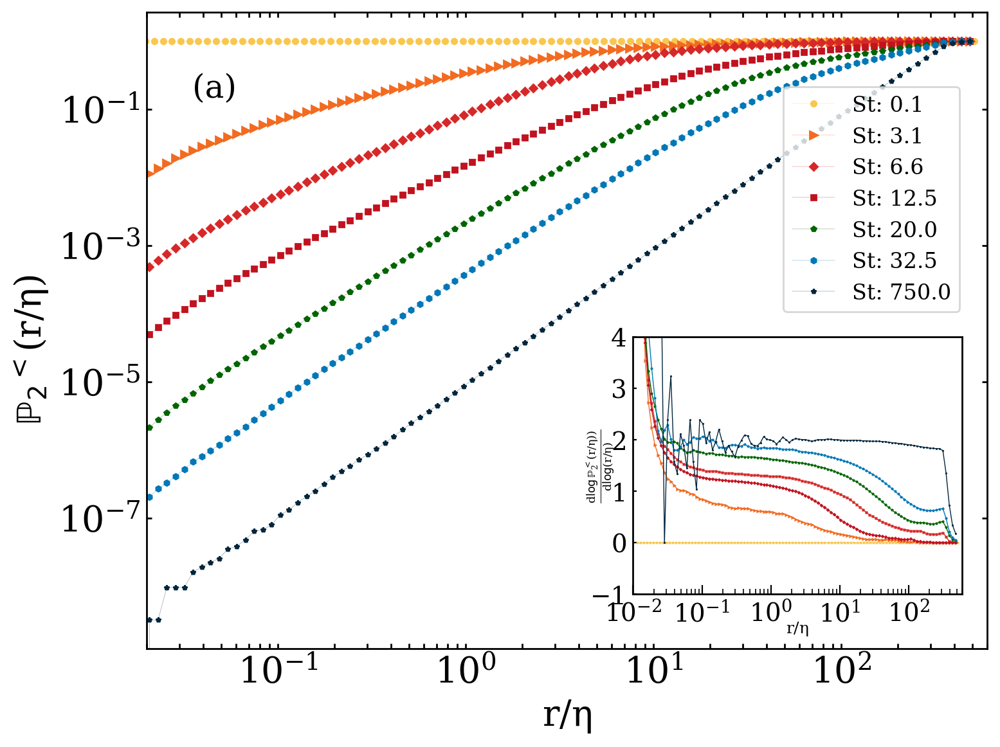

In [32]:
import numpy as np
import matplotlib.pyplot as plt
import os
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# -----------------------------
# FIGURE SETUP
# -----------------------------
fig, ax = plt.subplots(figsize=(8, 6), dpi = 200)

plt.rcParams.update({
    'font.family': 'serif',
    'font.size': 12,
    'axes.labelsize': 13,
    'axes.titlesize': 14,
    'axes.linewidth': 1.0,
    'xtick.direction': 'in',
    'ytick.direction': 'in',
    'xtick.major.size': 5,
    'ytick.major.size': 2,
    'xtick.minor.size': 3,
    'ytick.minor.size': 1,
    'legend.frameon': True,
    'mathtext.default': 'regular',
})

ax.tick_params(
    axis='both',
    which='both',
    labelsize=22,   # <<< BIGGER NUMBERS
    length=3,
    width=1,
    top=True,
    right=True
)



colors = [ '#f9c74f','#f26b21','#d62828','#c1121f', '#006400','#0077b6',"#01263d"]
markers = ['o','>' ,'s', 'D', 'p', 'h', '*']

# -----------------------------
# MAIN PLOTS
# -----------------------------

# 1
r_1 = np.load(os.path.join(folder_path, 'D2_PDF_CDF_bins_St_indx_0.npz'))['bins'] 
cdf_1 = np.load(os.path.join(folder_path, 'D2_PDF_CDF_bins_St_indx_0.npz'))['cdf'] 
ax.loglog(r_1/0.0087, cdf_1, 'o-', ms=3, label=f'St: {np.round(St[0],1)}', lw=0.1, marker=markers[0], color=colors[0])

# 2
r_1 = np.load(os.path.join(folder_path, 'D2_PDF_CDF_bins_St_indx_2.npz'))['bins'] 
cdf_1 = np.load(os.path.join(folder_path, 'D2_PDF_CDF_bins_St_indx_2.npz'))['cdf'] 
ax.loglog(r_1/0.0087, cdf_1, 'o-', ms=4, label=f'St: 3.1', lw=0.1, marker=markers[1], color=colors[1])

# 4
r_1 = np.load(os.path.join(folder_path_run_6, 'D2_PDF_CDF_bins_St_indx_9.npz'))['bins'] 
cdf_1 = np.load(os.path.join(folder_path_run_6, 'D2_PDF_CDF_bins_St_indx_9.npz'))['cdf'] 
ax.loglog(r_1/0.0087, cdf_1, 'o-', ms=3, label=f'St: 6.6', lw=0.1, marker=markers[3], color=colors[2])


# 3
r_1 = np.load(os.path.join(folder_path, 'D2_PDF_CDF_bins_St_indx_3.npz'))['bins'] 
cdf_1 = np.load(os.path.join(folder_path, 'D2_PDF_CDF_bins_St_indx_3.npz'))['cdf'] 
ax.loglog(r_1/0.0087, cdf_1, 'o-', ms=3, label=f'St: {St[3]}', lw=0.1, marker=markers[2], color=colors[3])

# 5
r_1 = np.load(os.path.join(folder_path_run_5, 'D2_PDF_CDF_bins_St_indx_5.npz'))['bins'] 
cdf_1 = np.load(os.path.join(folder_path_run_5, 'D2_PDF_CDF_bins_St_indx_5.npz'))['cdf'] 
ax.loglog(r_1/0.0087, cdf_1, 'o-', ms=3, label=f'St: {np.round(St_run_5[5])}', lw=0.1, marker=markers[4], color=colors[4])

# 6
r_1 = np.load(os.path.join(folder_path_run_5, 'D2_PDF_CDF_bins_St_indx_10.npz'))['bins'] 
cdf_1 = np.load(os.path.join(folder_path_run_5, 'D2_PDF_CDF_bins_St_indx_10.npz'))['cdf'] 
ax.loglog(r_1/0.0087, cdf_1, 'o-', ms=3, label=f'St: {np.round(St_run_5[10],1)}', lw=0.1, marker=markers[5], color=colors[5])

# 7
r_1 = np.load(os.path.join(folder_path_run_2, 'D2_PDF_CDF_bins_St_indx_10.npz'))['bins'] 
cdf_1 = np.load(os.path.join(folder_path_run_2, 'D2_PDF_CDF_bins_St_indx_10.npz'))['cdf'] 
ax.loglog(r_1/0.0087, cdf_1, 'o-', ms=3, label=f'St: {St_run_2[10]}', lw=0.1, marker=markers[6], color=colors[6])

# -----------------------------
# MAIN AXES FORMATTING
# -----------------------------
ax.legend(loc='upper right', bbox_to_anchor=(0.98, 0.9))

ax.set_xlabel(r"r/$\eta$", fontsize=20)
ax.set_ylabel(r"$\mathrm{\mathbb{P}_2}^<(r/\eta)$", fontsize=20)

ax.yaxis.label.set_position((1.0, 0.47))
ax.xaxis.label.set_position((0.5, 0.4))
plt.text(3.5e-2, 0.15, '(a)', fontsize=18, color='black')

ax.set_xlim(2e-2,600)
# -----------------------------
# INSET: LOCAL LOG SLOPES
# -----------------------------


axins = inset_axes(
    ax,
    width="43%",
    height="43%",
    loc="upper right",
    bbox_to_anchor=(0.06, -0.45, 0.91, 0.94),   # full axes bbox
    bbox_transform=ax.transAxes,
    borderpad=0.0
)

def local_log_slope(x, y):
    lx = np.log10(x)
    ly = np.log10(y)
    return np.gradient(ly, lx)

def plot_slope(folder, idx, marker, color):
    r = np.load(os.path.join(folder, f'D2_PDF_CDF_bins_St_indx_{idx}.npz'))['bins'] / 0.0087
    c = np.load(os.path.join(folder, f'D2_PDF_CDF_bins_St_indx_{idx}.npz'))['cdf']
    s = local_log_slope(r, c)
    axins.semilogx(r, s, marker=marker, ms=0.5 , lw=0.5, color=color )

plot_slope(folder_path, 0, markers[0], colors[0])
plot_slope(folder_path, 2, markers[1], colors[1])
plot_slope(folder_path, 3, markers[2], colors[2])
plot_slope(folder_path_run_6, 9, markers[3], colors[3])
plot_slope(folder_path_run_5, 5, markers[4], colors[4])
plot_slope(folder_path_run_5, 10, markers[5], colors[5])
plot_slope(folder_path_run_2, 10, markers[6], colors[6])

axins.set_xlabel(r"$r/\eta$", fontsize=9)
axins.set_ylabel(r"$ \frac{d\log \mathrm{\mathbb{P}}^<_2(r/\eta))}{d\log (r/\eta)}$", fontsize=9)
axins.tick_params(axis='both', labelsize=8, direction='in')

axins.set_ylim(-1,4)
# axins.grid(alpha=0.3)

# -----------------------------
# SAVE & SHOW
# -----------------------------
plt.tight_layout()
# ---- Make ONLY tick numbers larger (no change to tick bars) ----
ax.tick_params(
    axis='both',
    which='both',
    labelsize=20   # <<< increases only the number size
)

axins.tick_params(
    axis='both',
    which='both',
    labelsize=14   # <<< inset numbers
)

# axins.set_xlabel(r"$r/\eta$", fontsize=9, labelpad=-5)
# axins.set_ylabel(r"$d\log P^<_2/d\log r$", fontsize=9, labelpad=-5)

axins.set_xlim(1e-2, 6e2)
# Fine-tune label positions (axes coordinates)
axins.xaxis.set_label_coords(0.5, -0.1)
axins.yaxis.set_label_coords(-0.05, 0.5)



plt.savefig("particle_D2_CDF.png", dpi=200, bbox_inches='tight', pad_inches=0.01)
plt.show()


In [117]:
d2 = jnp.zeros(1)
err0r = []
window_min = []
window_max = []

In [118]:
window_size = 20  # number of points in each region

# Reject last 20 points
UV_cutoff = 30

IR_cutoff = 15

In [124]:
for i in range(0, 12):

    # Load data
    data = np.load(os.path.join(folder_path_run_6, f'D2_PDF_CDF_bins_St_indx_{i}.npz'))
    r = data['bins']
    cdf = data['cdf']

    # Apply lower cutoff
    r = r[IR_cutoff:]
    cdf = cdf[IR_cutoff:]

    # Compute local slope (log–log derivative)
    logr = np.log10(r)
    logs = np.gradient(np.log10(cdf), logr)

    # Define valid range (exclude UV_cutoff region at end)
    valid_range = len(logs) - window_size - UV_cutoff
    if valid_range <= 0:
        print(f"Skipping i={i} — not enough data after cutoffs")
        continue

    variances = np.array([
        np.var(logs[j:j + window_size])
        for j in range(valid_range)
    ])

    best_start = np.argmin(variances)
    best_region = slice(best_start, best_start + window_size)

    # Compute D2 and error
    D2 = np.mean(logs[best_region])
    error = np.std(logs[best_region])

    # Store results
    d2 = jnp.concatenate((d2, jnp.array([D2])))
    err0r.append(error)
    window_min.append(best_start + IR_cutoff)
    window_max.append(best_start + window_size + IR_cutoff)

    # Print summary
    print(f"\nStokes index {i}")
    print(f"Best region indices: {best_start + IR_cutoff}-{best_start + window_size + IR_cutoff}")
    print(f"D2 = {D2:.3f}, error = {error:.3e}")
    print(f"D2 max = {D2 + error:.3f}")
    print(f"Corresponding Stokes number: {St_run_5[i]}")


Stokes index 0
Best region indices: 49-69
D2 = 0.037, error = 3.285e-02
D2 max = 0.070
Corresponding Stokes number: 8.0

Stokes index 1
Best region indices: 49-69
D2 = 0.088, error = 5.568e-02
D2 max = 0.144
Corresponding Stokes number: 10.454545454545455

Stokes index 2
Best region indices: 26-46
D2 = 0.540, error = 4.856e-02
D2 max = 0.589
Corresponding Stokes number: 12.90909090909091

Stokes index 3
Best region indices: 28-48
D2 = 0.661, error = 3.065e-02
D2 max = 0.692
Corresponding Stokes number: 15.363636363636365

Stokes index 4
Best region indices: 28-48
D2 = 0.675, error = 5.423e-02
D2 max = 0.729
Corresponding Stokes number: 17.81818181818182

Stokes index 5
Best region indices: 23-43
D2 = 0.892, error = 6.395e-02
D2 max = 0.956
Corresponding Stokes number: 20.272727272727273

Stokes index 6
Best region indices: 29-49
D2 = 0.897, error = 3.994e-02
D2 max = 0.936
Corresponding Stokes number: 22.72727272727273

Stokes index 7
Best region indices: 24-44
D2 = 1.080, error = 5.3

In [125]:
# Sort correctly
indx = np.argsort(St)
St_sorted = St[indx]


err0r = np.array(err0r)[indx]
d2_plot = np.array(d2[1:]).ravel()
d2_plot = d2_plot[indx]

In [157]:
# jnp.savez(os.path.join(folder_path_run_4, f'D2_St_Vs_slope'), St = St , d2 = d2_plot )

final_plot_points = np.array([ 0, 1, 2, 3, 4, 5,6, 10, 14, 18,  22, 26, 30, 32, 40, 42, 44, 48, 50, 52, 54, 56, 58, 60, 62, 64, 66,68, 70])

In [156]:
time_stamp = 234

particle_pos_dumm = (jnp.load(os.path.join(folder_path, f'Velocity_Particle_Data_{time_stamp + 55}.npz'))['pos_particle'])

vel_field = (jnp.load(os.path.join(folder_path, f'Velocity_Particle_Data_{time_stamp + 55}.npz'))['v_spec'])

particle_pos_dumm_run_2 = (jnp.load(os.path.join(folder_path_run_2, f'Velocity_Particle_Data_{355+20}.npz'))['pos_particle'])

vel_field_run_2 = (jnp.load(os.path.join(folder_path_run_2, f'Velocity_Particle_Data_{355+20}.npz'))['v_spec'])

particle_data_0 = particle_pos_dumm[0]
particle_data_1 = particle_pos_dumm_run_2[1]
particle_data_2 = particle_pos_dumm_run_2[3]
particle_data_3 = particle_pos_dumm_run_2[8]
particle_data_3 = particle_pos_dumm_run_2[11]


div_field_run_2 = jnp.fft.irfft2(divergence(vel_field_run_2), norm = 'ortho').T


# Compute divergence field once
div_field = jnp.fft.irfft2(divergence(vel_field), norm = 'ortho').T

div_field_run_2 = jnp.fft.irfft2(divergence(vel_field_run_2), norm = 'ortho').T

vmin, vmax = div_field.min() , div_field.max()

vmin = -175

vmax = 25

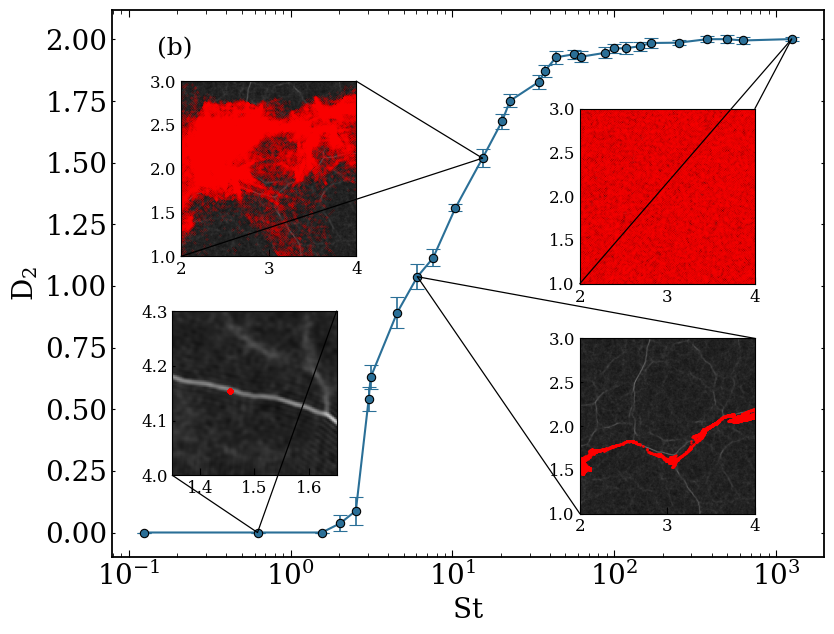

In [162]:
from matplotlib.patches import ConnectionPatch

# ================================
# Convert JAX arrays → NumPy
# ================================
St_np  = np.array(St_sorted)
d2_np  = np.array(d2_plot)
err_np = np.array(err0r)


plt.rcParams.update({
    'font.family': 'serif',
    'font.size': 12,
    'axes.labelsize': 13,
    'axes.titlesize': 14,
    'axes.linewidth': 1.0,
    'xtick.direction': 'in',
    'ytick.direction': 'in',
    'xtick.major.size': 5,
    'ytick.major.size': 2,
    'xtick.minor.size': 3,
    'ytick.minor.size': 1,
    'legend.frameon': True,
    'mathtext.default': 'regular',
})

fig, ax = plt.subplots(figsize=(8.5, 6.5))
ax.tick_params(axis='both', which='major', labelsize=20  )
ax.tick_params(axis='both', which='minor', labelsize=20  )
# ================================
# Main errorbar plot
# ================================
ax.errorbar(
    St_np[final_plot_points],
    d2_np[final_plot_points],
    yerr=err_np[final_plot_points],
    fmt='o-',
    color='#2a6f97',
    markersize=6,
    markeredgecolor='black',
    markeredgewidth=0.8,
    elinewidth=1.2,
    capsize=5,
    capthick=1.2,
    linewidth=1.5,
    label=r"$D_2$"
)

ax.set_xscale('log')
ax.set_xlabel(r"$St$")
ax.set_ylabel(r"$D_2$")
ax.tick_params(which='both', direction='in', top=True, right=True)
# Make axis labels larger
ax.set_xlabel(r"$St$", fontsize=20)
ax.set_ylabel(r"$D_2$", fontsize=20)

plt.text(0.15,1.936, '(b)', fontsize=18, color='black')

for spine in ax.spines.values():
    spine.set_linewidth(1.3)

# ================================
# Pick 4 points
# ================================
inset_indices = np.array([1,8, 11, 28])

x_pts = St_np[final_plot_points][inset_indices]
y_pts = d2_np[final_plot_points][inset_indices]

# ================================
# Fake velocity fields (replace with yours)
# ================================
vel_fields = [np.random.rand(40,40) for _ in range(4)]


# ================================
# Larger Inset locations
# ================================
inset_positions = [
    [0.05, 0.15, 0.3, 0.3],  # bottom-left (bigger)
    [0.62, 0.08, 0.32, 0.32],  # bottom-right (bigger)
    [0.06, 0.55, 0.32, 0.32],  # top-left (bigger)
    [0.62, 0.50, 0.32, 0.32],  # top-right (bigger)
]


for i in range(0,4):

    if i ==0:
        
        axins = ax.inset_axes(inset_positions[i])
        axins.scatter(particle_data_0[:, 1], particle_data_0[:, 0], s=10, color='red', zorder=2)
    
        axins.imshow(div_field.T, cmap='Greys',extent=[0, L, 0, L], origin='lower',vmin=vmin, vmax=vmax, zorder=1)
        axins.set_xlim(1.35,1.65)
        axins.set_ylim(4.0,4.3)

    elif i == 1:

        axins = ax.inset_axes(inset_positions[i])
        axins.scatter(particle_data_1[:, 1], particle_data_1[:, 0], s= 0.5, color='red', zorder=2)
        axins.imshow(div_field_run_2.T, cmap='Greys',extent=[0, L, 0, L], origin='lower',vmin=vmin, vmax=vmax, zorder=1)
        axins.set_xlim(2,4)
        axins.set_ylim(1.0,3.0)
    

    elif i == 2:

        axins = ax.inset_axes(inset_positions[i])
        axins.scatter(particle_data_2[:, 1], particle_data_2[:, 0], s= 0.01, color='red', zorder=2)
        axins.imshow(div_field_run_2.T, cmap='Greys',extent=[0, L, 0, L], origin='lower',vmin=vmin, vmax=vmax, zorder=1)
        axins.set_xlim(2,4)
        axins.set_ylim(1.0,3.0)

        
    else:
        axins = ax.inset_axes(inset_positions[i])
        axins.scatter(particle_data_3[:, 1], particle_data_3[:, 0], s= 0.01, color='red', zorder=2)
        axins.imshow(div_field_run_2.T, cmap='Greys',extent=[0, L, 0, L], origin='lower',vmin=vmin, vmax=vmax, zorder=1)
        axins.set_xlim(2,4)
        axins.set_ylim(1.0,3.0)

    for spine in axins.spines.values():
        spine.set_linewidth(0.8)

    # Two corners on inset box
    corner1 = (0.0, 0.0)   # bottom-left
    corner2 = (1.0, 1.0)   # top-right

    # First line
    con1 = ConnectionPatch(
        xyA=corner1, coordsA=axins.transAxes,
        xyB=(x_pts[i], y_pts[i]), coordsB=ax.transData,
        color='black', lw=0.9
    )

    # Second line
    con2 = ConnectionPatch(
        xyA=corner2, coordsA=axins.transAxes,
        xyB=(x_pts[i], y_pts[i]), coordsB=ax.transData,
        color='black', lw=0.9
    )

    fig.add_artist(con1)
    fig.add_artist(con2)

# ================================
# Save
# ================================
plt.tight_layout()
plt.savefig("d2_plot_with_edge_links.png", dpi=300, bbox_inches='tight')
plt.show()


# Analsys "à la Chen"

In [130]:
time_stamp = 0
particle_pos_dumm = (jnp.load(os.path.join(folder_path_run_5, f'Velocity_Particle_Data_{time_stamp}.npz'))['pos_particle'])[0]
vel_field = (jnp.load(os.path.join(folder_path_run_5, f'Velocity_Particle_Data_{time_stamp}.npz'))['v_spec'])

In [131]:
a_0 = A_0/N_particles
l_0 = jnp.sqrt(a_0)

bins_total = int(L/l_0)

count, x_edge, y_edge = jnp.histogram2d(particle_pos_dumm[:,0],particle_pos_dumm[:,1], bins = (bins_total,bins_total), range = [[0, L], [0, L]])
zeta_rms = calculate_rms(count)

l_0 = x_edge[1] - x_edge[0]

print(f"l_0 = {l_0}")
print(f"a_0 = {l_0**2}")
print(f"N_box = {int((4*pi**2)/l_0**2)}")
print(rf"Mean = {jnp.mean(count)}")

print(rf"RMS  =  {zeta_rms}")

print(rf"Std deviation  =  {jnp.std(count)}")

l_0 = 0.006135923151542565
a_0 = 3.764955292163604e-05
N_box = 1048576
Mean = 1.0
RMS  =  1.414184565044036
Std deviation  =  0.9999589911635322


In [193]:
particle_pos_dumm = (jnp.load(os.path.join(folder_path, f'Velocity_Particle_Data_{250}.npz'))['pos_particle'])

vel_field = (jnp.load(os.path.join(folder_path, f'Velocity_Particle_Data_{250}.npz'))['v_spec'])




particle_pos_dumm_run_2 = (jnp.load(os.path.join(folder_path_run_2, f'Velocity_Particle_Data_{240}.npz'))['pos_particle'])

vel_field_run_2 = (jnp.load(os.path.join(folder_path_run_2, f'Velocity_Particle_Data_{240}.npz'))['v_spec'])




particle_pos_dumm_run_4 = (jnp.load(os.path.join(folder_path_run_4, f'Velocity_Particle_Data_{346}.npz'))['pos_particle'])

vel_field_run_4 = (jnp.load(os.path.join(folder_path_run_4, f'Velocity_Particle_Data_{346}.npz'))['v_spec'])



particle_pos_dumm_run_4_f2 = (jnp.load(os.path.join(folder_path_run_4, f'Velocity_Particle_Data_{301}.npz'))['pos_particle'])

vel_field_run_4_f2 = (jnp.load(os.path.join(folder_path_run_4, f'Velocity_Particle_Data_{301}.npz'))['v_spec'])

In [194]:
# Compute divergence field once
div_field = jnp.fft.irfft2(divergence(vel_field), norm = 'ortho').T

div_field_run_2 = jnp.fft.irfft2(divergence(vel_field_run_2), norm = 'ortho').T

div_field_run_4 = jnp.fft.irfft2(divergence(vel_field_run_4), norm = 'ortho').T
div_field_run_4_f2 = jnp.fft.irfft2(divergence(vel_field_run_4_f2), norm = 'ortho').T


vmin, vmax = div_field.min() , div_field.max()

vmin = -150

vmax = 25

In [195]:
particle_data_0 = particle_pos_dumm_run_4[1]
particle_data_1 = particle_pos_dumm_run_4_f2[10]
particle_data_2 = particle_pos_dumm[9]
particle_data_3 = particle_pos_dumm[11]

count_0, x_edge, y_edge = jnp.histogram2d(particle_data_0[:,0],particle_data_0[:,1], bins = (bins_total,bins_total), range = [[0, L], [0, L]])
count_1, x_edge, y_edge = jnp.histogram2d(particle_data_1[:,0],particle_data_1[:,1], bins = (bins_total,bins_total), range = [[0, L], [0, L]])
count_2, x_edge, y_edge = jnp.histogram2d(particle_data_2[:,0],particle_data_2[:,1], bins = (bins_total,bins_total), range = [[0, L], [0, L]])
count_3, x_edge, y_edge = jnp.histogram2d(particle_data_3[:,0],particle_data_3[:,1], bins = (bins_total,bins_total), range = [[0, L], [0, L]])

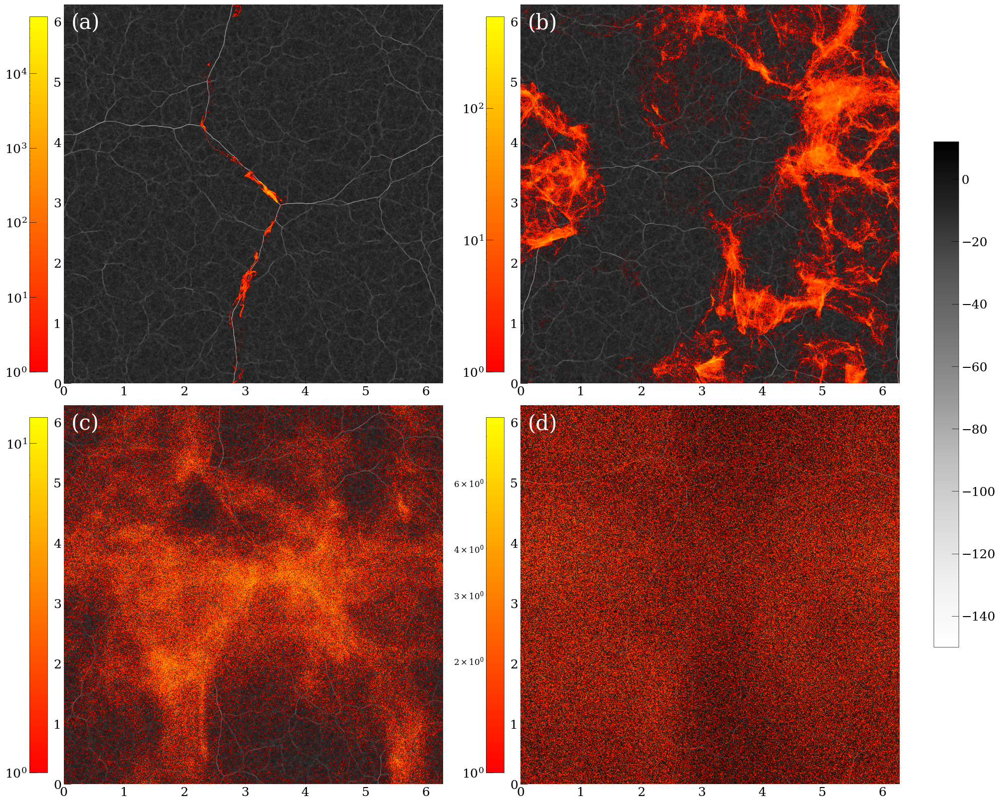

In [196]:
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

# === FIGURE SETUP ===
f, axarr = plt.subplots(2, 2, figsize=(20, 16), constrained_layout=True, dpi=100)
axarr = axarr.flatten()

# ---- STORE HANDLES ----
densities = []
div_images = []

# ---------------- PANEL (a) ----------------
im_density_0 = axarr[0].imshow(
    count_0.T,
    norm=LogNorm(vmin=count_0.min() + 1e0, vmax=count_0.max()),
    extent=[0, L, 0, L], origin='lower', zorder=2, cmap='autumn'
)
im_div_0 = axarr[0].imshow(
    div_field_run_4, cmap='Greys',
    extent=[0, L, 0, L], origin='lower',
    vmin=vmin, vmax=vmax, zorder=1
)
densities.append(im_density_0)
div_images.append(im_div_0)

# ---------------- PANEL (b) ----------------
im_density_1 = axarr[1].imshow(
    count_1,
    norm=LogNorm(vmin=count_1.min() + 1e0, vmax=count_1.max()),
    extent=[0, L, 0, L], origin='lower', zorder=2, cmap='autumn'
)
im_div_1 = axarr[1].imshow(
    div_field_run_4_f2, cmap='Greys',
    extent=[0, L, 0, L], origin='lower',
    vmin=vmin, vmax=vmax, zorder=1
)
densities.append(im_density_1)
div_images.append(im_div_1)

# ---------------- PANEL (c) ----------------
im_density_2 = axarr[2].imshow(
    count_2,
    norm=LogNorm(vmin=count_2.min() + 1e0, vmax=count_2.max()),
    extent=[0, L, 0, L], origin='lower', zorder=2, cmap='autumn'
)
im_div_2 = axarr[2].imshow(
    div_field.T, cmap='Greys',
    extent=[0, L, 0, L], origin='lower',
    vmin=vmin, vmax=vmax, zorder=1
)
densities.append(im_density_2)
div_images.append(im_div_2)

# ---------------- PANEL (d) ----------------
im_density_3 = axarr[3].imshow(
    count_3,
    norm=LogNorm(vmin=count_3.min() + 1e0, vmax=count_3.max()),
    extent=[0, L, 0, L], origin='lower', zorder=2, cmap='autumn'
)
im_div_3 = axarr[3].imshow(
    div_field_run_2.T, cmap='Greys',
    extent=[0, L, 0, L], origin='lower',
    vmin=vmin, vmax = 12, zorder=1
)
densities.append(im_density_3)
div_images.append(im_div_3)

# ---- MAKE AXIS TICKS LARGE ----
for ax in axarr:
    ax.tick_params(
        axis='both',
        labelsize=18,
        length=10,
        width=0.5,
        direction='in'
    )
    for spine in ax.spines.values():
        spine.set_visible(False)

# ========= INDIVIDUAL LEFT COLORBARS FOR COUNTS ==========
for ax, im in zip(axarr, densities):
    cb = f.colorbar(
        im,
        ax=ax,
        location='left',
        fraction=0.046,
        pad=0.02
    )
    cb.ax.tick_params(
        axis='y',
        labelsize=18,
        length=10,
        width=0.5,
        direction='in'
    )
    cb.outline.set_linewidth(0.5)

# ========= SINGLE RIGHT COLORBAR FOR DIVERGENCE ==========
cbar_div = f.colorbar(
    div_images[-1],
    ax=axarr,
    location='right',
    fraction=0.03,
    pad=0.04
)

cbar_div.ax.tick_params(
    axis='y',
    labelsize=18,
    length=10,
    width=0.5,
    direction='in'
)
cbar_div.outline.set_linewidth(0.5)

# ---- PANEL LABELS ----
panel_labels = ['a', 'b', 'c', 'd']
for ax, label in zip(axarr, panel_labels):
    ax.text(
        0.02, 0.98, f'({label})',
        transform=ax.transAxes,
        fontsize=30,
        # fontweight='bold',
        color='white',
        ha='left', va='top',
        zorder= 4
    )
    
plt.savefig('density.png', dpi = 100)
plt.show()

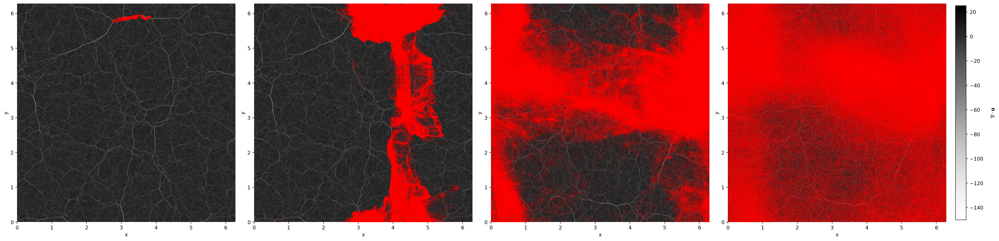

In [66]:
# Main figure with 4 panels
f, axarr = plt.subplots(1, 4, figsize=(28, 8), constrained_layout=True,dpi=200)


# ---------------- PANEL (a) ----------------
particle_data_0 = particle_pos_dumm_run_2[1]
axarr[0].scatter(particle_data_0[:, 1], particle_data_0[:, 0], s=0.01, color='red', zorder=2)
im0 = axarr[0].imshow(div_field_run_2.T, cmap='Greys', extent=[0, L, 0, L],origin='lower', vmin=vmin, vmax=vmax, zorder=1)
axarr[0].set_xlabel("x")
axarr[0].set_ylabel("y")
for spine in axarr[0].spines.values():
    spine.set_visible(False)

# ---------------- PANEL (b) ----------------
particle_data_1 = particle_pos_dumm_run_2[3]
axarr[1].scatter(particle_data_1[:, 1], particle_data_1[:, 0], s=0.01, color='red', zorder=2)
im0 = axarr[1].imshow(div_field_run_2.T, cmap='Greys', extent=[0, L, 0, L],origin='lower', vmin=vmin, vmax=vmax, zorder=1)
axarr[1].set_xlabel("x")
axarr[1].set_ylabel("y")
for spine in axarr[1].spines.values():
    spine.set_visible(False)

# ---------------- PANEL (c) ----------------
particle_data_2 = particle_pos_dumm_run_2[5]
axarr[2].scatter(particle_data_2[:, 0], particle_data_2[:, 1], s=0.01, color='red', zorder=2)
im0 = axarr[2].imshow(div_field_run_2, cmap='Greys', extent=[0, L, 0, L],origin='lower', vmin=vmin, vmax=vmax, zorder=1)
axarr[2].set_xlabel("x")
axarr[2].set_ylabel("y")
for spine in axarr[2].spines.values():
    spine.set_visible(False)


# ---------------- PANEL (d) ----------------
particle_data_3 = particle_pos_dumm_run_2[10]
axarr[3].scatter(particle_data_3[:, 0], particle_data_3[:, 1], s=0.01, color='red', zorder=2)
im3 = axarr[3].imshow(div_field_run_2, cmap='Greys', extent=[0, L, 0, L],
                      origin='lower', vmin=vmin, vmax=vmax, zorder=1)
axarr[3].set_xlabel("x")
axarr[3].set_ylabel("y")

for spine in axarr[3].spines.values():
    spine.set_visible(False)


    ax.set_xlabel("x")
    ax.set_ylabel("y")

    # Clean up axes
    for spine in ax.spines.values():
        spine.set_visible(False)

# ---- Add colorbar (like your reference figure) ----
cbar = f.colorbar(im0, ax=axarr, location='right', pad=0.01, shrink=0.76)
cbar.set_label(r'$\nabla \cdot \mathbf{u}$', labelpad=15)

plt.savefig("particle_field_divergence.png", dpi=100, bbox_inches='tight', pad_inches=0.01)
plt.show()

In [15]:
T_final = 1000

T_init = 200

In [99]:
# zeta_rms = jnp.zeros(((T_final - T_init)//save_interval,len(St_run_5)))

# counter = 0 

# for i in tqdm(range(T_init//save_interval ,T_final//save_interval)):

#     particle_pos_dumm = (jnp.load(os.path.join(folder_path_run_6, f'Velocity_Particle_Data_{i}.npz'))['pos_particle'])
    
#     for  j in range(len(St_run_6)):
        
#         dumm = particle_pos_dumm[j]
        
#         count, x_edge, y_edge = jnp.histogram2d(particle_pos_dumm[j,:,0],particle_pos_dumm[j,:,1], bins = (bins_total,bins_total), range = [[0, L], [0, L]])
        
#         zeta_rms = zeta_rms.at[counter,j].set(calculate_rms(count))

            
#     counter += 1

In [80]:
# jnp.savez(os.path.join(folder_path_run_6, f'Zeta_rms.npz'),zeta_rms = zeta_rms)

In [55]:
zeta_rms = jnp.load(os.path.join(folder_path, f'Zeta_rms.npz'))['zeta_rms']
zeta_rms_run_2 = jnp.load(os.path.join(folder_path_run_2, f'Zeta_rms.npz'))['zeta_rms']
zeta_rms_run_3 = jnp.load(os.path.join(folder_path_run_3, f'Zeta_rms.npz'))['zeta_rms']
zeta_rms_run_4 = jnp.load(os.path.join(folder_path_run_4, f'Zeta_rms.npz'))['zeta_rms']
zeta_rms_run_5 = jnp.load(os.path.join(folder_path_run_5, f'Zeta_rms.npz'))['zeta_rms']
zeta_rms_run_6 = jnp.load(os.path.join(folder_path_run_6, f'Zeta_rms.npz'))['zeta_rms']

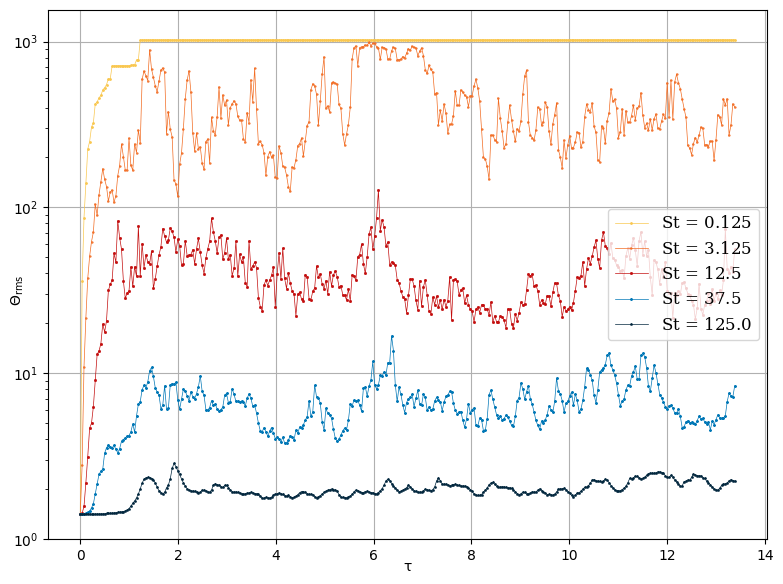

In [56]:
fig, ax = plt.subplots(figsize=(8, 6))

plt.rcParams.update({
    'font.family': 'serif',
    'font.size': 12,
    'axes.labelsize': 13,
    'axes.titlesize': 14,
    'axes.linewidth': 1.0,
    'xtick.direction': 'in',
    'ytick.direction': 'in',
    'xtick.major.size': 5,
    'ytick.major.size': 2,
    'xtick.minor.size': 3,
    'ytick.minor.size': 1,
    'legend.frameon': True,
    'mathtext.default': 'regular',
})

colors = ['#f9c74f', '#fbb040', '#f26b21', '#c30e0e','#6a040f','#0077b6',"#01263d"]
markers = ['o','>' ,'s', 'D', 'p', 'h', '*']

ax.plot(t[:350]/(0.16/dx),zeta_rms[:350,0],'o-', label = rf"$St$ = {St[0]}", color = colors[0], ms = 1 , lw = 0.5, marker = markers[0])
ax.plot(t[:350]/(0.16/dx),zeta_rms[:350,2], 'o-' ,label = rf"$St$ = {St[2]}", color = colors[2], ms = 1 , lw = 0.5, marker = markers[1])
ax.plot(t[:350]/(0.16/dx),zeta_rms[:350,3],'o-', label = rf"$St$ = {St[3]}", color = colors[3], ms = 1 , lw = 0.5, marker = markers[2])
ax.plot(t[:350]/(0.16/dx),zeta_rms[:350,4],'o-', label = rf"$St$ = {St[4]}", color = colors[5], ms = 1 , lw = 0.5, marker = markers[3])
ax.plot(t[:350]/(0.16/dx),zeta_rms[:350,6],'o-', label = rf"$St$ = {St[6]}", color = colors[6], ms = 1 , lw = 0.5, marker = markers[4])

ax.set_ylim(1,1550)

ax.grid()
ax.set_xlabel(r"$\tau$", labelpad = -2)
ax.set_ylabel(r"$\Theta_{rms}$", labelpad = -10)
ax.legend(loc = 'right')

ax.yaxis.label.set_position((1.0, 0.47))

ax.set_yscale('log')
# ax.text(0.78, 6.475, "(a)", transform=axarr[0].transAxes,fontsize=17, color='black')
plt.tight_layout()

plt.savefig("Theta_rms.png", dpi=600, bbox_inches='tight', pad_inches=0.01)

plt.show()

In [57]:
# Sort correctly
indx = jnp.argsort(St)
St_sorted = St[indx]

In [58]:
data = np.mean(zeta_rms[250:], axis = 0)
error = np.std(zeta_rms[250:], axis = 0)


data_run_2 = np.mean(zeta_rms_run_2[250:], axis = 0)
error_run_2 = np.std(zeta_rms_run_2[250:], axis = 0)


data_run_3 = np.mean(zeta_rms_run_3[250:], axis = 0)
error_run_3 = np.std(zeta_rms_run_3[250:], axis = 0)


data_run_4 = np.mean(zeta_rms_run_4[250:], axis = 0)
error_run_4 = np.std(zeta_rms_run_4[250:], axis = 0)



data_run_5 = np.mean(zeta_rms_run_5[250:], axis = 0)
error_run_5 = np.std(zeta_rms_run_5[250:], axis = 0)



data_run_6 = np.mean(zeta_rms_run_6[250:], axis = 0)
error_run_6 = np.std(zeta_rms_run_6[250:], axis = 0)



data_plot = jnp.append(data,data_run_2)
error_plot = jnp.append(error,error_run_2)


data_plot = jnp.append(data_plot,data_run_3)
error_plot = jnp.append(error_plot,error_run_3)

data_plot = jnp.append(data_plot,data_run_4)
error_plot = jnp.append(error_plot,error_run_4)

data_plot = jnp.append(data_plot,data_run_5)
error_plot = jnp.append(error_plot,error_run_5)

data_plot = jnp.append(data_plot,data_run_6)
error_plot = jnp.append(error_plot,error_run_6)



data_plot = jnp.array(data_plot).ravel()
error_plot = jnp.array(error_plot).ravel()


data_plot = data_plot[indx]

error_plot = error_plot[indx]

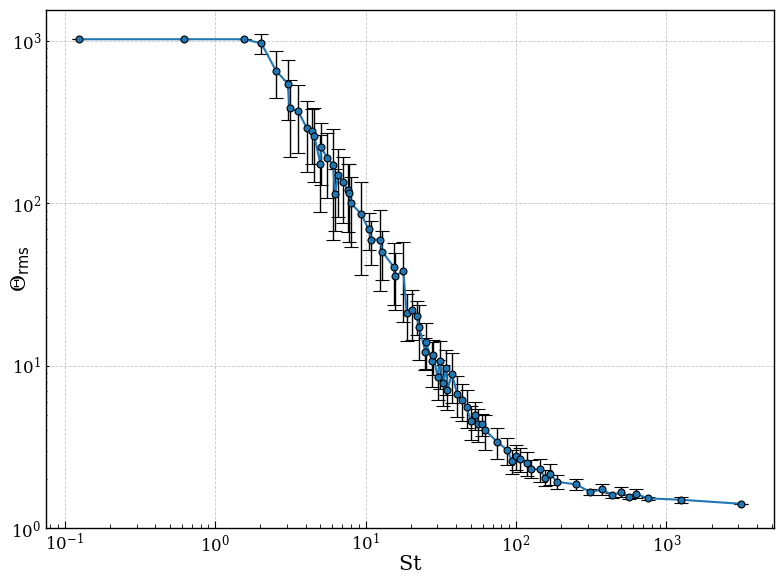

In [59]:

afig, ax = plt.subplots(figsize=(8, 6))

# --- Main data with error bars ---
ax.errorbar(
    St_sorted[:], data_plot[:],yerr=error_plot[:], markersize=5,fmt = 'o-',
    color='tab:blue', ecolor='black',
    elinewidth=1, capsize=5, capthick=1.2,
    markeredgecolor='black', markeredgewidth=0.8,
    label=r"Data"
)

# --- Reference line ---
# ax.plot(
#     [St[2] +2, St[45] +2],
#     [data_plot[2] + 6 , data_plot[45] + 6 ],
#     color='black', linewidth=1.5,
#     label=r"Reference line"
# )

# --- Axes formatting ---
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel(r"$St$", fontsize=15 ,labelpad = 0)
ax.set_ylabel(r"$\Theta_{\mathrm{rms}}$", fontsize=15,labelpad = -15)
ax.set_ylim(1,1550)

# ax.legend(frameon=False, fontsize=12)

# --- Grid and appearance ---
ax.grid(which='major', linestyle='--', linewidth=0.6, alpha=0.7)
# ax.grid(which='minor', linestyle=':', linewidth=0.4, alpha=0.5)
plt.tight_layout()

# --- Save high-quality figure ---
plt.savefig("error_plot.png", dpi=600, bbox_inches='tight')
plt.show()
# print("Slope of reference line :" ,np.round((data_plot[45] - data_plot[4])/(St[45]-St[4]),1))




In [139]:
final_plot_points = np.array([ 0, 1, 2,  4,    8, 10, 12,  16, 18,  22, 26, 30, 32, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60, 62, 64, 66,68, 70, 72])
final_plot_points

array([ 0,  1,  2,  4,  8, 10, 12, 16, 18, 22, 26, 30, 32, 40, 42, 44, 46,
       48, 50, 52, 54, 56, 58, 60, 62, 64, 66, 68, 70, 72])

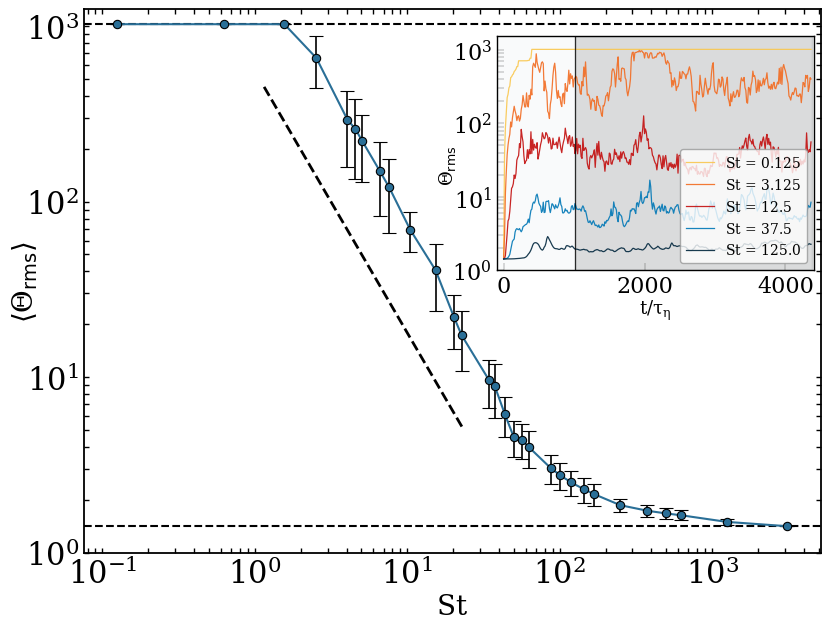

In [141]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# ================================
# Global Matplotlib styling
# ================================
plt.rcParams.update({
    'font.family': 'serif',
    'font.size': 13,
    'axes.labelsize': 20,
    'axes.titlesize': 16,
    'axes.linewidth': 1.2,
    'xtick.direction': 'in',
    'ytick.direction': 'in',
    'xtick.major.size': 2,
    'ytick.major.size': 2,
    'xtick.minor.size': 1,
    'ytick.minor.size': 1.0,
    'legend.frameon': True,
    'mathtext.default': 'regular',
})

# ================================
# FIRST PLOT (Main figure)
# ================================
fig, ax = plt.subplots(figsize=(8.5, 6.5))

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_ylim(1, 1250)

# Slightly thicker frame
for spine in ax.spines.values():
    spine.set_linewidth(1.3)

# Main data
ax.errorbar(
    St_sorted[final_plot_points],
    data_plot[final_plot_points],
    yerr=error_plot[final_plot_points],
    fmt='o-', markersize=6,
    color='#2a6f97',
    ecolor='black',
    elinewidth=1.2, capsize=5, capthick=1.2,
    markeredgecolor='black', markeredgewidth=0.8,
    label=r"Data"
)


# Labels
ax.set_xlabel(r"$St$", labelpad=2)
ax.set_ylabel(r"$ \langle \Theta_{\mathrm{rms}} \rangle$", labelpad=-10)

# Horizontal reference lines
ax.axhline(1024, linestyle='--', lw=1.5, color='black')
ax.axhline(np.sqrt(2), linestyle='--', lw=1.5, color='black')

ax.tick_params(
    axis='both',
    which='both',
    labelsize=22,   # <<< BIGGER NUMBERS
    length=3.5,
    width=1,
    top=True,
    right=True
)


plt.plot([1.15, 23.5], [450, 5] ,'--' ,lw = 2 , color = 'black' )

# ================================
# INSET PLOT
# ================================
axins = inset_axes(
    ax,
    width="43%",
    height="43%",
    loc="upper right",
    bbox_to_anchor=(-0.01, -0.05, 1.0, 1.0),
    bbox_transform=ax.transAxes,
    borderpad=0.0
)

axins.set_facecolor("#f9fafb")

colors = ['#f9c74f', '#fbb040', '#f26b21', '#c30e0e',
          '#6a040f', '#0077b6', '#01263d']

# Inset curves
axins.plot(t[:350]/0.16, zeta_rms[:350, 0], '-', color=colors[0], lw=0.9, alpha=0.9, label=rf"$St$ = {St[0]}")
axins.plot(t[:350]/0.16, zeta_rms[:350, 2], '-', color=colors[2], lw=0.9, alpha=0.9, label=rf"$St$ = {St[2]}")
axins.plot(t[:350]/0.16, zeta_rms[:350, 3], '-', color=colors[3], lw=0.9, alpha=0.9, label=rf"$St$ = {St[3]}")
axins.plot(t[:350]/0.16, zeta_rms[:350, 4], '-', color=colors[5], lw=0.9, alpha=0.9, label=rf"$St$ = {St[4]}")
axins.plot(t[:350]/0.16, zeta_rms[:350, 6], '-', color=colors[6], lw=0.9, alpha=0.9, label=rf"$St$ = {St[6]}")

# Inset formatting
axins.set_yscale('log')
axins.set_xlim(-100, 4400)
axins.set_ylim(1, 1550)

axins.set_xlabel(r"$t/\tau_\eta$", fontsize=13, labelpad=1)
axins.set_ylabel(r"$\Theta_{\mathrm{rms}}$", fontsize=13, labelpad=-4)


# Legend
axins.legend(loc='lower right', fontsize=10, framealpha=0.8, edgecolor='0.6')

# Highlight region
axins.axvline(1015, color='black', lw=0.9, alpha=0.8)
axins.axvspan(1015, 4380, alpha=0.12, color='black')

# Label tweak
axins.yaxis.label.set_position((-1.1, 0.45))

# Spines
for spine in axins.spines.values():
    spine.set_linewidth(1.0)

axins.tick_params(
    axis='both',
    which='both',
    labelsize=16,   # <<< bigger numbers for inset
    length=5,
    width= 0.2,
    direction='in'
)
    

# ================================
# Final layout + save
# ================================
plt.tight_layout()
plt.savefig("error_plot_with_inset.png", dpi=600, bbox_inches='tight')
plt.show()


# Quasi-Lagrangian coarse grained density PDF


In [16]:
box_size = 0.15
total_bins = int(L/box_size)

start_time = 200 # Start time
T_final = 1000   #Final time

skip = 50
rho = np.zeros((int((T_final-start_time)/skip),len(St),total_bins,total_bins))

counter = 0
n_bins = 30

In [17]:
for i in tqdm(range(start_time,T_final,skip)):

  particle_pos_dumm = (jnp.load(os.path.join(folder_path_run_2, f'Velocity_Particle_Data_{i//skip}.npz'))['pos_particle'])

  for j in range(len(St_run_2)):

    dumm = particle_pos_dumm[j]

    count, _, _ = jnp.histogram2d(dumm[:,0],dumm[:,1], bins = (total_bins,total_bins), range = [[0, L], [0, L]])

    rho_dumm = count*(L**2)/(N_particles*(box_size**2))

    rho[counter,j,:,:] = rho_dumm

  counter +=  1

100%|███████████████████████████████████████████| 16/16 [00:14<00:00,  1.08it/s]


In [17]:
# jnp.savez(os.path.join(folder_path_run_2, f'micro_scale_Quasi_Lagrangian_density.npz'),rho = rho)

In [111]:
rho = jnp.load(os.path.join(folder_path, f'Quasi_Lagrangian_density.npz'))['rho']

rho_run_2_r_0p075 = jnp.load(os.path.join(folder_path_run_2, f'Quasi_Lagrangian_density_r_0p075.npz'))['rho']
rho_run_2_r_0p15 = jnp.load(os.path.join(folder_path_run_2, f'Quasi_Lagrangian_density.npz'))['rho']
rho_run_2_r_0p3 = jnp.load(os.path.join(folder_path_run_2, f'Quasi_Lagrangian_density_r_0p3.npz'))['rho']
rho_run_2_r_0p6 = jnp.load(os.path.join(folder_path_run_2, f'Quasi_Lagrangian_density_r_0p6.npz'))['rho']

rho_run_3 = jnp.load(os.path.join(folder_path_run_3, f'Quasi_Lagrangian_density.npz'))['rho']
rho_run_4 = jnp.load(os.path.join(folder_path_run_4, f'Quasi_Lagrangian_density.npz'))['rho']
rho_run_4 = jnp.load(os.path.join(folder_path_run_5, f'Quasi_Lagrangian_density.npz'))['rho']

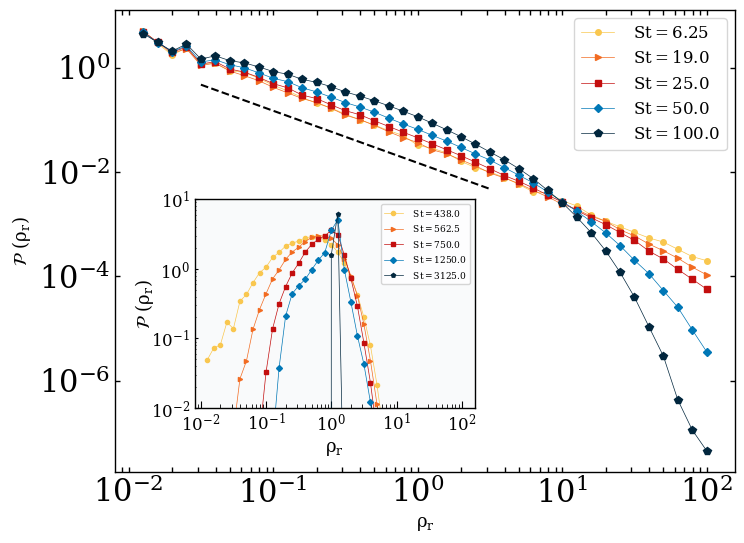

In [116]:
fig, ax = plt.subplots(figsize=(8, 6))

plt.rcParams.update({
    'font.family': 'serif',
    'font.size': 12,
    'axes.labelsize': 13,
    'axes.titlesize': 14,
    'axes.linewidth': 1.0,
    'xtick.direction': 'in',
    'ytick.direction': 'in',
    'xtick.major.size': 5,
    'ytick.major.size': 2,
    'xtick.minor.size': 3,
    'ytick.minor.size': 1,
    'legend.frameon': True,
    'mathtext.default': 'regular',
})

ax.tick_params(
    axis='both',
    which='both',
    labelsize=22,   # <<< BIGGER NUMBERS
    length=3.5,
    width=1,
    top=True,
    right=True
)


colors = ['#f9c74f', '#fbb040', '#f26b21', '#c30e0e','#6a040f','#0077b6',"#01263d"]
markers = ['o','>' ,'s', 'D', 'p', 'h', '*']


plt.xlabel(r"$\rho_r$")
plt.ylabel(r"$\mathcal{P} \, \, (\rho_r)$")
bins_dumm = jnp.logspace(-2,2,41)


# data_hist = rho_run_2_r_0p075[:,2,:,:].flatten()
# hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
# plt.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=3 , lw = 0.5, label = r" $St = $" +f'{St_run_2[2]}', color = colors[0], marker = markers[0])

#----------------------------------------------------------------------------------------------------------------#



data_hist = rho_run_2_r_0p15[:,1,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
plt.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=4 , lw = 0.5, label = r" $St = $" +f'{St_run_2[1]}', color = colors[0], marker = markers[0])

data_hist = rho_run_3[:,1,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
plt.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=4 , lw = 0.5, label = r" $St = $" +f'{np.round(St_run_3[1],0)}', color = colors[2], marker = markers[1])


data_hist = rho_run_2_r_0p15[:,2,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
plt.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=4 , lw = 0.5, label = r" $St = $" +f'{St_run_2[2]}', color = colors[3], marker = markers[2])


data_hist = rho_run_2_r_0p15[:,3,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
plt.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=4 , lw = 0.5, label = r" $St = $" +f'{St_run_2[3]}', color = colors[5], marker = markers[3])

data_hist = rho_run_3[:,7,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
plt.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=5.35 , lw = 0.5, label = r" $St = $" +f'{St_run_3[7]}', color = colors[6], marker = markers[4])

plt.loglog(bins_dumm[5:26], 0.015/bins_dumm[5:26], '--', color = 'black')
plt.legend()

#----------------------------------------------------------------------------------------------------------------#

axins = inset_axes(
    ax,
    width="43%",
    height="43%",
    loc="upper right",
    bbox_to_anchor=(-0.47, -0.46, 1.05, 1.05),
    bbox_transform=ax.transAxes,
    borderpad=0.0
)

axins.set_facecolor("#f9fafb")

colors = ['#f9c74f', '#fbb040', '#f26b21', '#c30e0e',
          '#6a040f', '#0077b6', '#01263d']

# Inset curves



data_hist = rho_run_2_r_0p15[:,8,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
axins.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=3 , lw = 0.5, label = r" $St = $" +f'{np.round(St_run_2[8],0)}', color = colors[0], marker = markers[0])


data_hist = rho_run_2_r_0p15[:,9,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
axins.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=3 , lw = 0.5, label = r" $St = $" +f'{St_run_2[9]}', color = colors[2], marker = markers[1])


data_hist = rho_run_2_r_0p15[:,10,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
axins.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=3 , lw = 0.5, label = r" $St = $" +f'{St_run_2[10]}', color = colors[3], marker = markers[2])


data_hist = rho[:,11,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
axins.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=3 , lw = 0.5, label = r" $St = $" +f'{St_run_1[11]}', color = colors[5], marker = markers[3])


data_hist = rho_run_2_r_0p15[:,11,:,:].flatten()
hist , edges = jnp.histogram(data_hist,  bins = bins_dumm , density = True)
axins.loglog(edges[1:],(hist)/jnp.std(hist),'o-',ms=3 , lw = 0.5, label = r" $St = $" +f'{St_run_2[11]}', color = colors[6], marker = markers[4])


axins.set_ylim(1e-2, 10)
plt.legend(loc = 'upper right' ,prop={'size': 6.5})
axins.set_xlabel(r"$\rho_r$")
axins.set_ylabel(r"$\mathcal{P} \, \, (\rho_r)$", fontsize=13, labelpad=-4)

#----------------------------------------------------------------------------------------------------------------#



plt.savefig("Quasi_Lagrangian_Density.png", dpi=600, bbox_inches='tight')

plt.show()

In [ ]:
# jnp.savez(os.path.join(folder_path_run_2, f'Quasi_Lagrangian_density.npz'),rho = rho)

# Micro scale PDFs

# Approach Statistics

In [ ]:
start_time = 200
end_time = 500

skip = 2
n_bins = 100

counter = 0

key1 = jax.random.PRNGKey(78489)
key2 = jax.random.PRNGKey(7848)



random_pos_indx_1 = jax.random.randint(key1, (N_particles,), 0, N_particles-1)
random_pos_indx_2 = jax.random.randint(key2, (N_particles,), 0, N_particles-1)

w = jnp.zeros(1)
rel_pos = jnp.zeros(1)

In [ ]:
w_list, rel_pos_list = [], []

for time_stamp in tqdm(range(100, 500, 2)):
  data = jnp.load(os.path.join(folder_path, f'Velocity_Particle_Data_{time_stamp}.npz'))
  particle_pos_dumm = data['pos_particle'][6]
  particle_vel_dumm = data['vel_particle'][6]

  r1 = particle_pos_dumm[random_pos_indx_1]
  v1 = particle_vel_dumm[random_pos_indx_1]
  r2 = particle_pos_dumm[random_pos_indx_2]
  v2 = particle_vel_dumm[random_pos_indx_2]

  rel_pos = r2 - r1
  rel_vel = v2 - v1

  w_dumm = jnp.sum(rel_pos * rel_vel, axis=1) / jnp.sqrt(jnp.sum(rel_pos**2, axis=1))

  w_dumm = jnp.nan_to_num(w_dumm, nan= 1.0, posinf=1.0, neginf=1.0)

  cond = (w_dumm < 0) & (~jnp.isnan(w_dumm))

  w_list.append(w_dumm[cond])
  rel_pos_list.append(jnp.sqrt(jnp.sum(rel_pos[cond]**2, axis=1)))


100%|██████████| 200/200 [12:26<00:00,  3.73s/it]


In [ ]:
def coarse_grain(x, w, n_bins):

    x_min, x_max = jnp.min(x) + 4e-3, jnp.max(x)

    bins = jnp.logspace(jnp.log10(x_min), jnp.log10(x_max), n_bins + 1)
    bin_centers = 0.5 * (bins[:-1] + bins[1:])

    # Assign each x to a bin index
    inds = jnp.digitize(x, bins) - 1   # bins start from 0

    # Compute sums and counts per bin
    w_sum = jnp.bincount(inds, weights=w, length=n_bins)
    counts = jnp.bincount(inds, length=n_bins)

    # Avoid division by zero
    w_mean = jnp.where(counts > 0, w_sum / counts, jnp.nan)

    return bin_centers, w_mean

In [ ]:
# w = jnp.concatenate(w_list)
# rel_pos = jnp.concatenate(rel_pos_list)

w_f = np.load(os.path.join(folder_path, f'approach_rate_St_indx_6.npz'))['w_f']
r =  np.load(os.path.join(folder_path, f'approach_rate_St_indx_6.npz'))['r']

# r , w_f = coarse_grain(rel_pos, w, n_bins=50)


dr = r[1] - r[0]
w_f = jnp.nan_to_num(w_f, nan=0.0)

pdf = w_f / (jnp.sum(w_f) * dr)
cdf = dr * jnp.cumsum(pdf)
cdf = cdf / cdf[-1]  # optional safeguard: ensure last value = 1

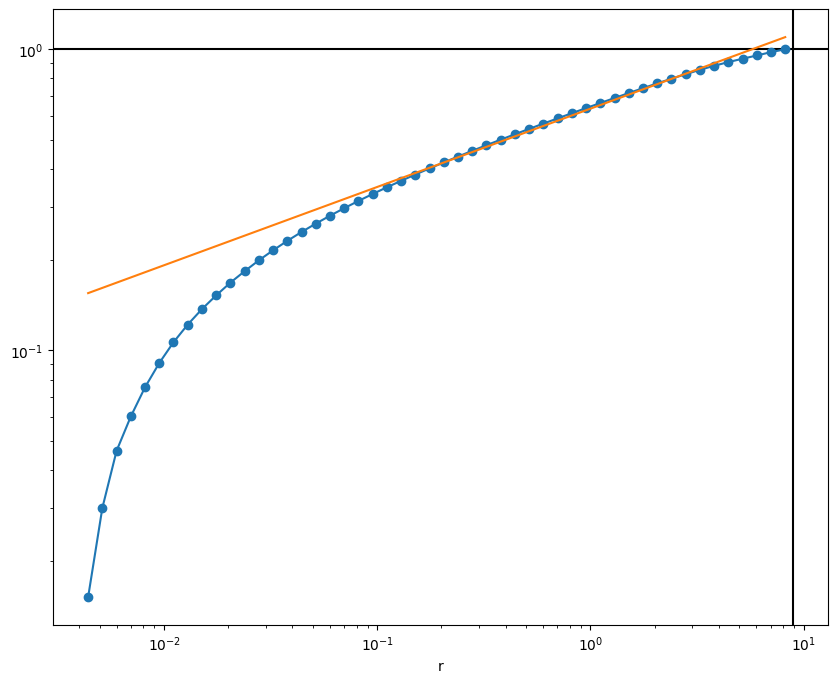

In [ ]:
plt.figure(figsize=(10, 8))

plt.xlabel(r"r")
plt.axhline(1,color = 'black')
plt.axvline(jnp.sqrt(2)*2*pi,color = 'black')

plt.plot(r,cdf,'o-')
plt.plot(r[:],6.35e-1*r[:]**(0.26))
plt.xscale('log')
plt.yscale('log')

In [ ]:
# jnp.savez(os.path.join(folder_path, f'approach_rate_St_indx_6.npz'),r = r , w_f = w_f)

# Animation


In [197]:
####################################################################################
'''
Importing Libraries

1. Scientific functions:

    a) numpy
    b) scipy
    c) JAX (GPU)

2. Plotting:

    a) matplotlib

3. Just-In-Time compilation : JAX
'''
####################################################################################

import scipy as sc
import torch as torch

import numpy as np
import jax
import jax.numpy as jnp

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn
import glob

import pathlib,json,os,time



from matplotlib.animation import FFMpegWriter



import warnings
warnings.filterwarnings("ignore")

from tqdm import tqdm

jax.config.update('jax_enable_x64', True) # Set float-64 as a Default variable type.

In [198]:
@jax.jit
def divergence(u):

  return jnp.fft.irfft2(jnp.sum(derivative_operator*u,0), norm = 'ortho')


100%|█████████████████████████████████████████| 500/500 [04:26<00:00,  1.87it/s]


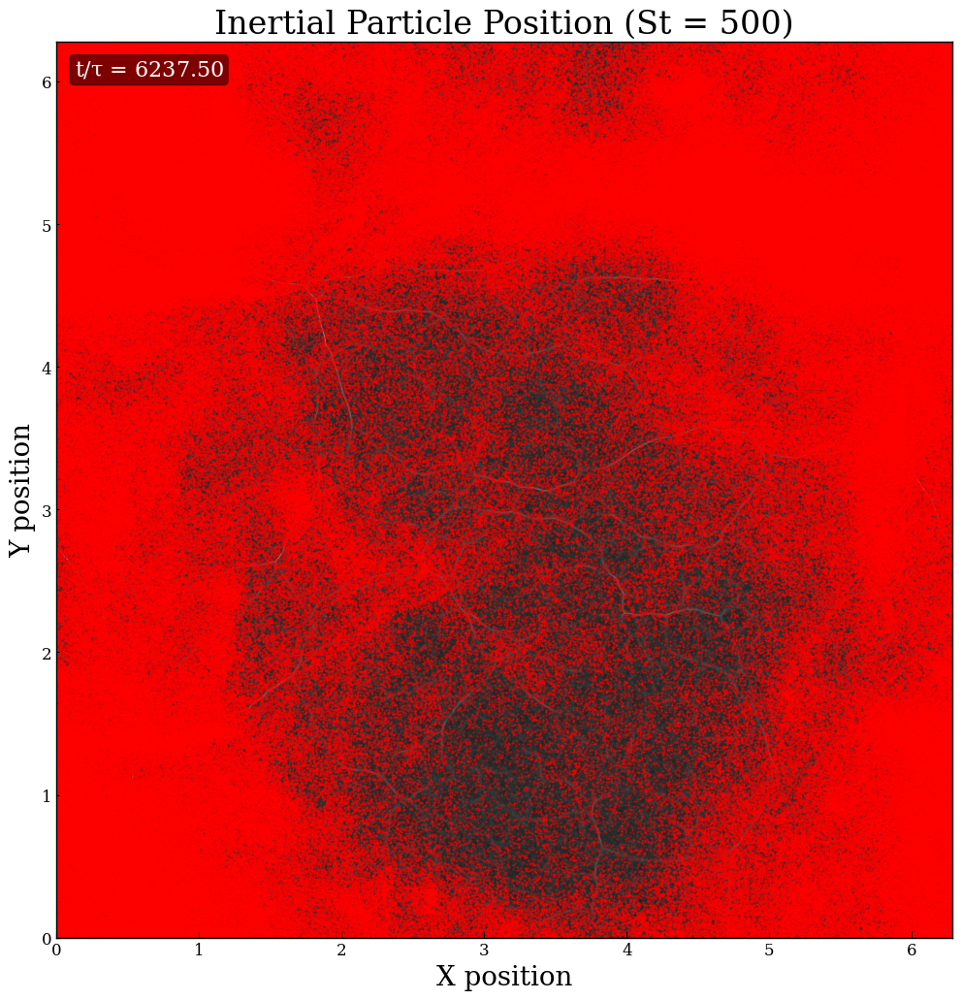

In [217]:
n_frames = 500
L = 2 * np.pi

dt = 2 * 6.25
T_final = 1000

fig, ax = plt.subplots(figsize=(12, 12))


writer = FFMpegWriter(fps=30, codec="libx264")

with writer.saving(fig, f"particles_dynamics_St_{St_run_1[9]}.mp4", dpi=150):

    for i in tqdm(range(n_frames)):
        
        data = np.load(os.path.join(folder_path, f"Velocity_Particle_Data_{i}.npz"))
        vel = data["v_spec"]
        div_field = divergence(vel)
        pos = data["pos_particle"][9]

        ax.clear()
        ax.set_xlim(0, L)
        ax.set_ylim(0, L)

        # === REMOVE LABELS/TITLE if you want *absolute* zero whitespace ===
        ax.set_xlabel('X position', fontsize=20)
        ax.set_ylabel('Y position', fontsize=20)
        ax.set_title(f'Inertial Particle Position (St = 500)', fontsize=24)

        ax.grid(False)

        im = ax.imshow(div_field.T, extent=[0, L, 0, L], 
                       origin="lower", cmap="Grays")

        ax.scatter(pos[:, 0], pos[:, 1], s=0.2, c="red", alpha=0.7)

        time = i * dt
        ax.text(0.02, 0.98,
                rf"$t/\tau$ = {time:.2f}",
                transform=ax.transAxes,
                fontsize=16, color="white",
                ha="left", va="top",
                bbox=dict(boxstyle="round,pad=0.2",
                          fc="black", alpha=0.5))

        writer.grab_frame()
